# DeepEM: A Deep Neural Network for DEM Inversion
by Paul Wright$^{1}$, Mark Cheung, Rajat Thomas, Richard Galvez, Alexandre Szenicer, Meng Jin, Andres Munoz-Jaramillo, and David Fouhey


$^{1}$ University of Glasgow; email: paul@pauljwright.co.uk

The intensity observed through optically-thin SDO/AIA filters (94 Å, 131 Å, 171 Å, 193 Å, 211 Å, 335 Å) can be related to the temperature distribution of the solar corona (the differential emission measure; DEM) as

\begin{equation}
g_{i} = \int_{T} K_{i}(T) \xi(T) dT \, .
\end{equation}

In this equation, $g_{i}$ is the DN s$^{-1}$ px$^{-1}$ value in the $i$th SDO/AIA channel. This intensity corresponds to the $K_{i}(T)$ temperature response function, and the DEM, $\xi(T)$, is in units of cm$^{-5}$ K$^{-1}$. The matrix formulation of this integral equation can be represented in the form, $\vec{g} = {\bf K}\vec{\xi}$, however, this problem is an ill-posed inverse problem, and any attempt to directly recover $\vec{\xi}$ leads to significant noise amplication. 

There are numerous methods to tackle mathematical problems of this kind, and there are an increasing number of methods in the literature for recovering the differential emission measure including methods based tecniques such as Tikhonov Regularisation (Hannah & Kontar 2012), on the concept of sparsity (Cheung et al 2015). In the following notebook, we will demonstrate how a simple 1x1 2D convolutional neural network allows for significant improvement in computational speed for DEM inversion with similar fidelity to the method used for training (Basis Pursuit). Additionally this method, DeepEM, provides solutions with values of emission measure >0 in every temperature bin.

# DeepEM: A Deep Learning Approach for DEM Inversion

Paul J. Wright, Mark Cheung, Rajat Thomas, Richard Galvez, Alexandre Szenicer, Meng Jin, Andres Munoz-Jaramillo, and David Fouhey

---

In this chapter we will introduce a Deep Learning approach for DEM Inversion. <i>For this notebook</i>, DeepEM is a trained on one set of <i>SDO</i>/AIA observations (six optically thin channels; $6 \times N \times N$) and DEM solutions (in 18 temperature bins from log$_{10}$T = 5.5 - 7.2, $18 \times N \times N$; Cheung <i>et al</i> 2015) at a resolution of $512 \times 512$ ($N = 512$) using a $1 \times 1$ 2D Convolutional Neural Network with a single hidden layer.

The DeepEM method presented here takes every DEM solution with no regards to the quality or existence of the solution. As will be demonstrated, when this method is trained with a single set images and DEM solutions, the DeepEM solutions have a similar fidelity to Sparse Inversion (with a significantly increased computation speed), and additionally, the DeepEM solutions find positive solutions at every pixel, and reduced noise in the DEM solutions.

In [1]:
import os
import json
import time
import torch
import numpy as np
import pandas as pd
import torch.nn as nn
from scipy.io import readsav
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from torch.autograd import Variable
from torch.utils.data import DataLoader

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
def em_scale(y):
    return np.sqrt(y/1e25)

def em_unscale(y):
    return 1e25*(y*y)

def img_scale(x):
    x2 = x
    bad = np.where(x2 <= 0.0)
    x2[bad] = 0.0
    return np.sqrt(x2)

def img_unscale(x):
    return x*x 

### Step 1: Obtain Data and Sparse Inversion Solutions for Training



We first load the <i>SDO</i>/AIA images and Basis Pursuit DEM maps.

N.B. While this simplified version of DeepEM has been trained on DEM maps from Basis Pursuit (Cheung <i>et al.</i> 2015), we actively encourage the readers to try their favourite method for DEM inversion! 

In [3]:
aia_files = ['AIA_DEM_2011-01-27','AIA_DEM_2011-02-22','AIA_DEM_2011-03-20']
em_cube_files = aia_files

for k, (afile, emfile) in enumerate(zip(aia_files, em_cube_files)):
    afile_name = os.path.join('./DeepEM_Data/', afile + '.aia.npy')
    emfile_name = os.path.join('./DeepEM_Data/', emfile + '.emcube.npy')
    if k == 0:
        X = np.load(afile_name)
        y = np.load(emfile_name)
 
        X = np.zeros((len(aia_files), X.shape[0], X.shape[1], X.shape[2]))
        y = np.zeros((len(em_cube_files), y.shape[0], y.shape[1], y.shape[2]))
        
        nlgT = y.shape[0]
        lgtaxis = np.arange(y.shape[1])*0.1 + 5.5
        
    X[k] = np.load(afile_name)
    y[k] = np.load(emfile_name) 

### Step 2: Define the Model

We first define the model as a 1x1 2D Convolutional Neural Network (CNN) with a kernel size of 1x1. The model accepts a data cube of $6 \times N \times N$ (<i>SDO</i>/AIA data), and returns a data cube of $18 \times N \times N$ (DEM). which when trained, will transform the input (each pixel of the 6 SDO/AIA channels; $6 \times 1 \times 1$) to the output (DEM at each pixel; $18 \times 1 \times 1$).

In [4]:
model = nn.Sequential(
    nn.Conv2d(6, 300, kernel_size=1),
    nn.LeakyReLU(), #Activation function
    nn.Conv2d(300, 300, kernel_size=1),
    nn.LeakyReLU(),
    nn.Conv2d(300, 18, kernel_size=1)).cuda() #Loading model on to gpu

### Step 3: Train the Model

For training our CNN we select one <i>SDO</i>/AIA data cube ($6\times512\times512$) and the corresponding Sparse Inversion DEM output ($18\times512\times512$). In the case presented here, we train the CNN on an image of the Sun obtained on 27-01-2011, validate on an image of the Sun obtained one synodic rotation later (+26 days; 22-02-2011), and finally test on an image another 26 days later (20-03-2011).

In [5]:
X = img_scale(X)
y = em_scale(y)

X_train = X[0:1] 
y_train = y[0:1] 

X_val = X[1:2] 
y_val = y[1:2] 

X_test = X[2:3] 
y_test = y[2:3]

#### Plotting SDO/AIA Observations ${\it vs.}$ Basis Pursuit DEM bins

For the test data set, the <i>SDO</i>/AIA images for 171 Å, 211 Å, and 94 Å, and the corresponding DEM bins near the peak sensitivity in these relative isothermal channel (logT = 6.3, 5.9) are shown in Figure 1. Figure 1 shows a set of <i>SDO</i>/AIA images (171 Å, 211 Å, and 94 Å [Left to Right]) with the corresponding DEM maps for temperature bins there are near the peak sensitivity of the <i>SDO</i>/AIA channel. Furthermore, it is clear from the DEM maps that a number of pixels that are $zero$. These pixels are primarily located off-disk, but there are a number of pixels on-disk that show this behaviour.

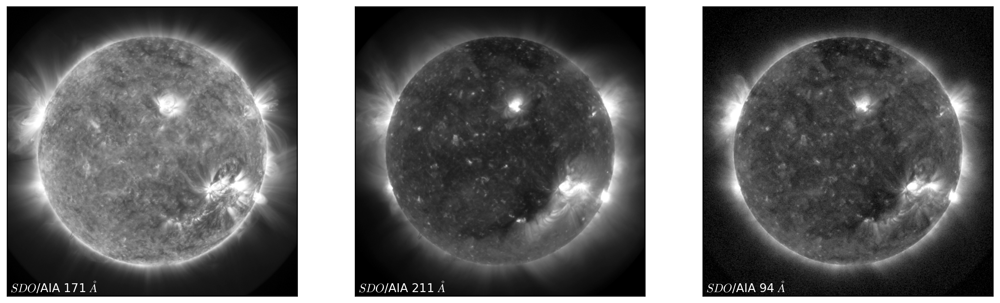

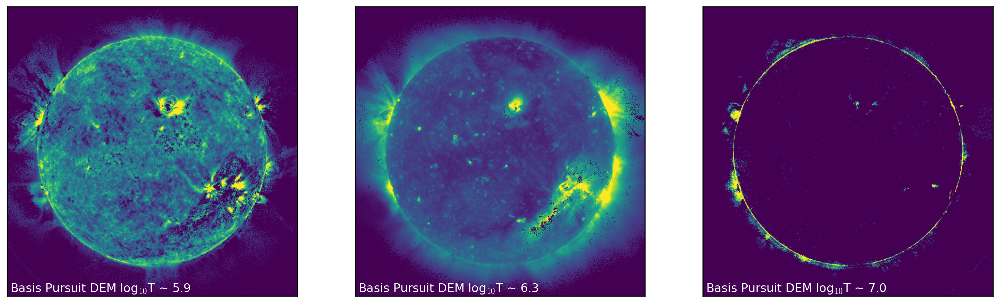

In [6]:
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(X_test[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, '${\it SDO}$/AIA 211 $\AA$', color="white", size='large')
ax[0].imshow(X_test[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, '${\it SDO}$/AIA 171 $\AA$', color="white", size='large')
ax[2].imshow(X_test[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, '${\it SDO}$/AIA 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(y_test[0,8,:,:],vmin=0.25,vmax=10,cmap='viridis')
ax[1].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 6.3', color="white", size='large')
#ax[1].scatter(x=[400], y=[80], c='w', s=50, marker='x') 
ax[0].imshow(y_test[0,4,:,:],vmin=0.01,vmax=3,cmap='viridis')
ax[0].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 5.9', color="white", size='large')
ax[2].imshow(y_test[0,15,:,:],vmin=0.01,vmax=3,cmap='viridis')
ax[2].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 7.0', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)

<b>Figure 1:</b> Left to Right: <i>SDO</i>/AIA images in 171 Å, 211 Å, and 94 Å (top), with the corresponding DEM bins (chosen at the peak sensitivity of each of the <i>SDO</i>/AIA channels) shown below. In the DEM bins (bottom) it is clear that there are some pixels that have solutions of DEM = $zero$, as explicitly seen as dark regions/clusters of pixels on and off disk.

---

To implement training and testing of our model, we first define a DEMdata class, and define functions for training and validation/test: train_model, and valtest_model. 

N.B. It is not necessary to train the model, and if required, the trained model can be loaded to the cpu as follows:

```python
model = nn.Sequential(
    nn.Conv2d(6, 300, kernel_size=1),
    nn.LeakyReLU(),
    nn.Conv2d(300, 300, kernel_size=1),
    nn.LeakyReLU(),
    nn.Conv2d(300, 18, kernel_size=1))
    
dem_model_file = 'DeepEM_CNN_HelioML.pth'
model.load_state_dict(torch.load(dem_model_file, map_location='cpu'))
```

Once you have loaded the the model, skip to <b>Step 4: Testing the Model</b>.

In [7]:
class DEMdata(nn.Module):
    def __init__(self, xtrain, ytrain, xtest, ytest, xval, yval, split='train'):
        
        if split == 'train':
            self.x = xtrain
            self.y = ytrain
        if split == 'val':
            self.x = xval
            self.y = yval
        if split == 'test':
            self.x = xtest
            self.y = ytest
            
    def __getitem__(self, index):
        return torch.from_numpy(self.x[index]).type(torch.FloatTensor), torch.from_numpy(self.y[index]).type(torch.FloatTensor)

    def __len__(self):
        return self.x.shape[0]

In [8]:
def train_model(dem_loader, criterion, optimizer, epochs=500):
    model.train()
    train_loss_all_batches = []
    train_loss_epoch = []
    train_val = []
    for k in range(epochs):
        count_ = 0
        avg_loss = 0
        # =================== progress indicator ==============
        if k % ((epochs + 1) // 4) == 0:
            print('[{0}]: {1:.1f}% complete: '.format(k, k / epochs * 100))
        # =====================================================
        for img, dem in dem_loader:
            count_ += 1
            optimizer.zero_grad()
            # =================== forward =====================
            img = img.cuda()
            dem = dem.cuda()

            output = model(img) 
            loss = criterion(output, dem)

            loss.backward()
            optimizer.step()
            
            train_loss_all_batches.append(loss.item())
            avg_loss += loss.item()
        # =================== Validation ===================
        dem_data_val = DEMdata(X_train, y_train, X_test, y_test, X_val, y_val, split='val')
        dem_loader_val = DataLoader(dem_data_val, batch_size=1)
        val_loss, dummy, dem_pred_val, dem_in_test_val = valtest_model(dem_loader_val, criterion)
        
        train_loss_epoch.append(avg_loss/count_)
        train_val.append(val_loss)
        
        print('Epoch: ', k, 'trn_loss: ', avg_loss/count_, 'val_loss: ', train_val[k])
            
    torch.save(model.state_dict(), 'DeepEM_CNN_HelioML.pth')
    return train_loss_epoch, train_val

def valtest_model(dem_loader, criterion):

    model.eval()
    
    val_loss = 0
    count = 0
    test_loss = []
    for img, dem in dem_loader:
        count += 1
        # =================== forward =====================
        img = img.cuda()
        dem = dem.cuda()
        
        output = model(img)
        loss = criterion(output, dem)
        test_loss.append(loss.item())
        val_loss += loss.item()
        
    return val_loss/count, test_loss, output, dem

We choose the Adam optimiser with a learning rate of 1e-4, and weight_decay set to 1e-9. We use Mean Squared Error (MSE) between the Sparse Inversion DEM map and the DeepEM map as our loss function.

In [9]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001, weight_decay=1e-9); 
criterion = nn.MSELoss().cuda()

Using the defined functions, dem_data will return the training data, and this will be loaded by the DataLoader with batch_size=1 (one 512 x 512 image per batch). For each epoch, train_loss and valdn_loss will be returned by train_model

In [10]:
dem_data = DEMdata(X_train, y_train, X_test, y_test, X_val, y_val, split='train')
dem_loader = DataLoader(dem_data, batch_size=1)

t0=time.time() #Timing how long it takes to predict the DEMs
train_loss, valdn_loss = train_model(dem_loader, criterion, optimizer, epochs=500)
ttime = "Training time = {0} seconds".format(time.time()-t0)
print(ttime)

[0]: 0.0% complete: 
Epoch:  0 trn_loss:  2.211900472640991 val_loss:  2.3412883281707764
Epoch:  1 trn_loss:  2.0418665409088135 val_loss:  2.1650094985961914
Epoch:  2 trn_loss:  1.8821855783462524 val_loss:  1.9994359016418457
Epoch:  3 trn_loss:  1.732445240020752 val_loss:  1.8444578647613525
Epoch:  4 trn_loss:  1.5925333499908447 val_loss:  1.6999993324279785
Epoch:  5 trn_loss:  1.4623682498931885 val_loss:  1.5664299726486206
Epoch:  6 trn_loss:  1.3422213792800903 val_loss:  1.444068431854248
Epoch:  7 trn_loss:  1.2323580980300903 val_loss:  1.3330515623092651
Epoch:  8 trn_loss:  1.1327922344207764 val_loss:  1.2327927350997925
Epoch:  9 trn_loss:  1.043084979057312 val_loss:  1.1428008079528809
Epoch:  10 trn_loss:  0.9627913236618042 val_loss:  1.062804937362671
Epoch:  11 trn_loss:  0.8916780948638916 val_loss:  0.9925096035003662
Epoch:  12 trn_loss:  0.8294593691825867 val_loss:  0.9315062761306763
Epoch:  13 trn_loss:  0.7757624983787537 val_loss:  0.8793330788612366


#### Plotting: MSE Loss for Training and Validation 

In order to understand how well the model has trained we plot the training loss and validation loss as a function of Epoch in Figure 2. Figure 2 shows the MSE loss for training (blue) and validation (orange) as a function of epoch.

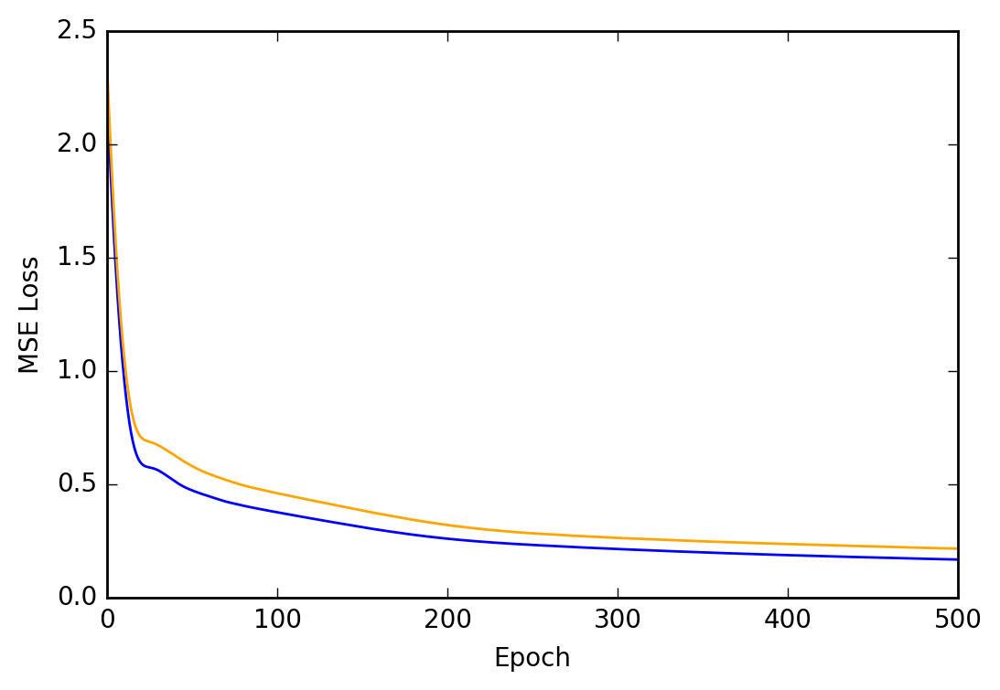

In [11]:
plt.plot(np.arange(len(train_loss[:])), train_loss[:], color="blue")
plt.plot(np.arange(len(train_loss[:])), valdn_loss[:], color="orange")
plt.xlabel('Epoch')
plt.ylabel('MSE Loss')
plt.show()

<b>Figure 2:</b> Training and Validation MSE loss (blue, orange) as a function of Epoch.

---

### Step 4: Testing the Model

Now that the model has been trained, testing the model is a computationally cheap proceedure. As before, we choose the data using DEMdata, and load with DataLoader. Using valtest_model, the DeepEM map is created ${\texttt{output = model(img)}}$, and the MSE loss calculated as during training.

In [12]:
dem_data_test = DEMdata(X_train, y_train, X_test, y_test, X_val, y_val, split='test')
dem_loader = DataLoader(dem_data_test, batch_size=1)

t0=time.time() #Timing how long it takes to predict the DEMs
dummy, test_loss, dem_pred, dem_in_test = valtest_model(dem_loader, criterion)
performance = "Number of DEM solutions per second = {0}".format((y_test.shape[2]*y_test.shape[3])/(time.time()-t0))

print(performance)

Number of DEM solutions per second = 3130834.8456553183


#### Plotting: AIA, Basis Pursuit, DeepEM 

With the DeepEM map calculated, we can now compare the solutions obtained by Basis Pursuit and DeepEM. Figure 3 is similar to Figure 1 with an additional row corresponding to the solutions for DeepEM. Figure 3 shows <i>SDO</i>/AIA images in 171 Å, 211 Å, and 94 Å (top), with the corresponding DEM bins from Basis Pursuit (chosen at the peak sensitivity of each of the <i>SDO</i>/AIA channels) shown below (middle). The bottom row shows the DeepEM solutions that correspond to the same bins as the Basis Pursuit solutions. DeepEM provides solutions that are similar to Basis Pursuit, but importantly, provides DEM solutions for every pixel.

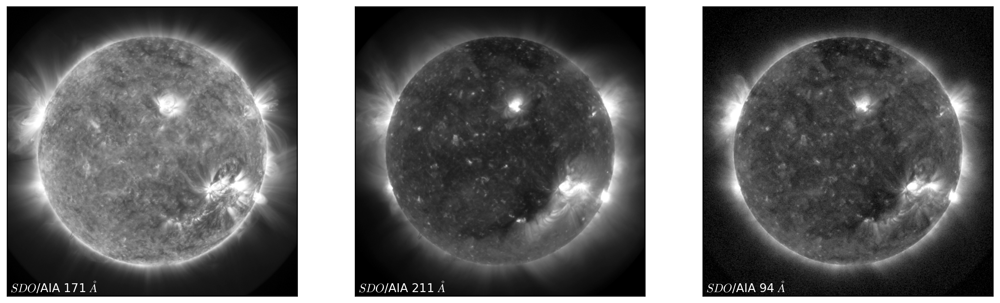

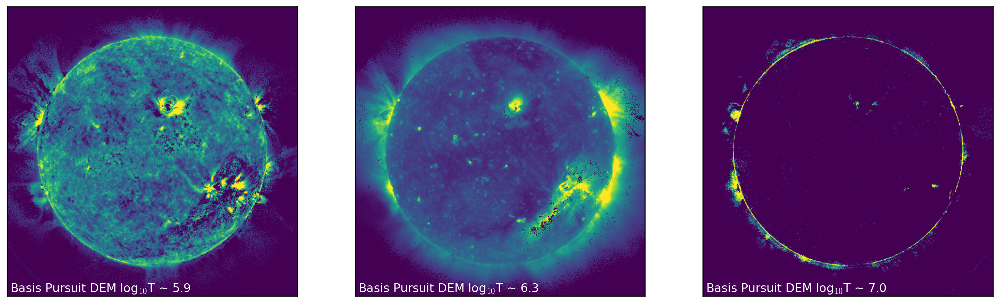

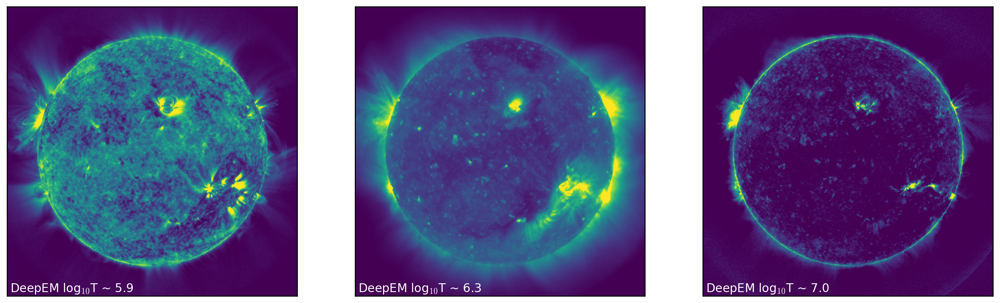

In [13]:
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(X_test[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, '${\it SDO}$/AIA 211 $\AA$', color="white", size='large')
ax[0].imshow(X_test[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, '${\it SDO}$/AIA 171 $\AA$', color="white", size='large')
ax[2].imshow(X_test[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, '${\it SDO}$/AIA 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(dem_in_test[0,8,:,:].cpu().detach().numpy(),vmin=0.25,vmax=10,cmap='viridis')
ax[1].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 6.3', color="white", size='large')
#ax[1].scatter(x=[400], y=[80], c='w', s=50, marker='x') 
ax[0].imshow(dem_in_test[0,4,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[0].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 5.9', color="white", size='large')
ax[2].imshow(dem_in_test[0,15,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[2].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 7.0', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(dem_pred[0,8,:,:].cpu().detach().numpy(),vmin=0.25,vmax=10,cmap='viridis')
ax[1].text(5, 512.-7.5, 'DeepEM log$_{10}$T ~ 6.3', color="white", size='large')
#ax[1].scatter(x=[400], y=[80], c='w', s=50, marker='x') 
ax[0].imshow(dem_pred[0,4,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[0].text(5, 512.-7.5, 'DeepEM log$_{10}$T ~ 5.9', color="white", size='large')
ax[2].imshow(dem_pred[0,15,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[2].text(5, 512.-7.5, 'DeepEM log$_{10}$T ~ 7.0', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)

<b>Figure 3</b>: Left to Right: <i>SDO</i>/AIA images in 171 Å, 211 Å, and 94 Å (top), with the corresponding DEM bins from Basis Pursuit (chosen at the peak sensitivity of each of the <i>SDO</i>/AIA channels) shown below (middle). The bottom row shows the DeepEM solutions that correspond to the same bins as the Basis Pursuit solutions. DeepEM provides solutions that are similar to Basis Pursuit, but importantly, provides DEM solutions for every pixel.



---

Furthermore, as we have the original Basis Pursuit DEM solutions ("the ground truth"), we can compare the average DEM from Basis Pursuit to the average DEM from DeepEM, as they should be similar. Figure 4 shows the average Basis Pursuit DEM (black curve) and the DeepEM solution (light blue bars/dotted line).

In [14]:
def PlotTotalEM(em_unscaled, em_pred_unscaled, lgtaxis, status):
    mask = np.zeros([status.shape[0],status.shape[1]])
    mask[np.where(status == 0.0)] = 1.0
    nmask = np.sum(mask)
    
    EM_tru_sum = np.zeros([lgtaxis.size])
    EM_inv_sum = np.zeros([lgtaxis.size])
    
    for i in range(lgtaxis.size):
        EM_tru_sum[i] = np.sum(em_unscaled[0,i,:,:]*mask)/nmask
        EM_inv_sum[i] = np.sum(em_pred_unscaled[0,i,:,:]*mask)/nmask
        
    fig = plt.figure   
    plt.plot(lgtaxis,EM_tru_sum, linewidth=3, color="black")
    plt.plot(lgtaxis,EM_inv_sum, linewidth=3, color="lightblue", linestyle='--')
    plt.tick_params(axis='both', which='major')#, labelsize=16)
    plt.tick_params(axis='both', which='minor')#, labelsize=16)
    
    dlogT = lgtaxis[1]-lgtaxis[0]
    plt.bar(lgtaxis-0.5*dlogT, EM_inv_sum, dlogT, linewidth=2, color='lightblue')
    
    plt.xlim(lgtaxis[0]-0.5*dlogT, lgtaxis.max()+0.5*dlogT)
    plt.xticks(np.arange(np.min(lgtaxis), np.max(lgtaxis),2*dlogT))
    plt.ylim(1e24,1e27)
    plt.yscale('log')
    plt.xlabel('log$_{10}$T [K]')
    plt.ylabel('Mean Emission Measure [cm$^{-5}$]')
    plt.title('Basis Pursuit (curve) vs. DeepEM (bars)')
    
    plt.show()
    return EM_inv_sum, EM_tru_sum

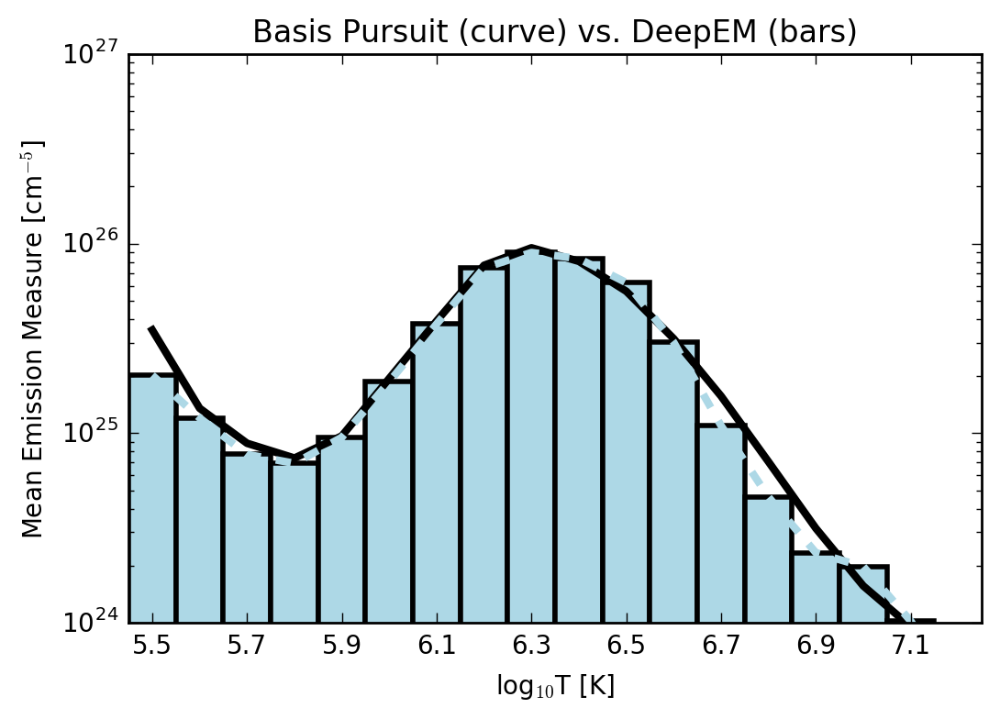

In [15]:
em_unscaled = em_unscale(dem_in_test.detach().cpu().numpy())
em_pred_unscaled = em_unscale(dem_pred.detach().cpu().numpy())
status = np.zeros([512,512]) #Setting statuses to zero here, but could be provided
                   
EMinv, EMTru = PlotTotalEM(em_unscaled,em_pred_unscaled,lgtaxis,status)

<b>Figure 4</b>: Average Basis Pursuit DEM (black line) against the Average DeepEM solution (light blue bars/dotted line). It is clear that this simple implementation of DeepEM provides, on average, DEMs that are similar to Basis Pursuit (Cheung <i>et al</i> 2015).

---

### Step 5: Synthesize <i>SDO</i>/AIA Observations

Finally, it is also of interest to reconstruct the <i>SDO</i>/AIA observations from both the Basis Pursuit, and DeepEM solutions. 

We are able to pose the problem of reconstructing the <i>SDO</i>/AIA observations from the DEM as a 1x1 2D Convolution. We first define the weights as the response functions of each channel, and set the biases to $zero$. By convolving the unscaled DEM at each pixel with the 6 filters (one for each <i>SDO</i>/AIA response function), we can recover the <i>SDO</i>/AIA observations.

In [16]:
# We first load the AIA response functions:
cl = np.load('./DeepEM_Data/chianti_lines_AIA.npy')

In [17]:
# Used Conv2d to convolve?? every pixel (18x1x1) by the 6 response functions
# to return a set of observed fluxes in each channel (6x1x1)
dem2aia = nn.Conv2d(18, 6, kernel_size=1).cuda()

chianti_lines_2 = torch.zeros(6,18,1,1).cuda()
biases = torch.zeros(6).cuda()

# set the weights to each of the SDO/AIA response functions and biases to zero
for i, p in enumerate(dem2aia.parameters()):
    if i == 0:
        p.data = Variable(torch.from_numpy(cl).type(torch.cuda.FloatTensor))
    else:
        p.data = biases 

In [18]:
AIA_out = img_scale(dem2aia(Variable(em_unscale(dem_in_test))).detach().cpu().numpy())
AIA_out_DeepEM = img_scale(dem2aia(Variable(em_unscale(dem_pred))).detach().cpu().numpy())

#### Plotting SDO/AIA Observations and Synthetic Observations

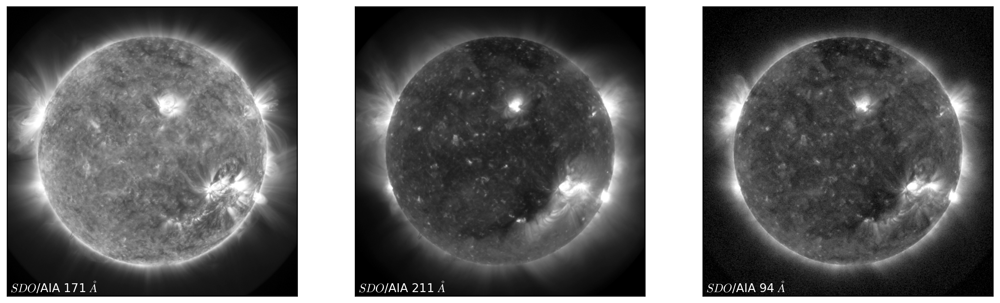

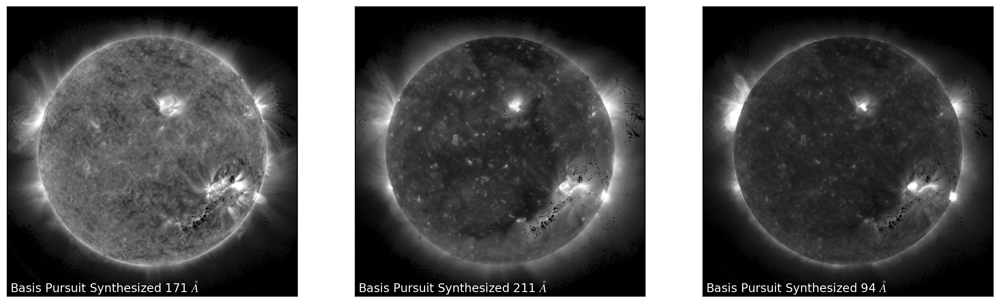

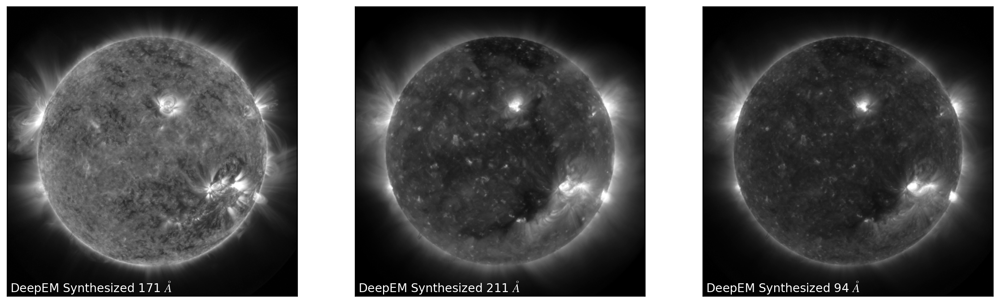

In [19]:
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(X_test[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, '${\it SDO}$/AIA 211 $\AA$', color="white", size='large')
ax[0].imshow(X_test[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, '${\it SDO}$/AIA 171 $\AA$', color="white", size='large')
ax[2].imshow(X_test[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, '${\it SDO}$/AIA 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(AIA_out[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, 'Basis Pursuit Synthesized 211 $\AA$', color="white", size='large')
ax[0].imshow(AIA_out[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, 'Basis Pursuit Synthesized 171 $\AA$', color="white", size='large')
ax[2].imshow(AIA_out[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, 'Basis Pursuit Synthesized 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(AIA_out_DeepEM[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, 'DeepEM Synthesized 211 $\AA$', color="white", size='large')
ax[0].imshow(AIA_out_DeepEM[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, 'DeepEM Synthesized 171 $\AA$', color="white", size='large')
ax[2].imshow(AIA_out_DeepEM[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, 'DeepEM Synthesized 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    

<b>Figure 5:</b> Left to Right: <i>SDO</i>/AIA images in 171 Å, 211 Å, and 94 Å (top) with the corresponding synthesised observations from Basis Pursuit (middle) and DeepEM (bottom). DeepEM provides synthetic observations that are similar to Basis Pursuit, with the addition of solutions where the basis pursuit solution was $zero$.

---

### Discussion

This chapter has provided an example of how a 1x1 2D Convolutional Neural Network can be used to improve computational cost for DEM inversion. Future improvements to DeepEM can come in a few ways:

First, by using both the original, and synthesised data from the DEM, the ability of the DEM to recover the original or supplementary data can be used as a additional term in the loss function. Furthermore, we could use a number of additional data to further constrain the DEMs:
    
* Use SDO/AIA Data to correct the DEMs
* Use MEGS-A EUV to correct the DEMs
* Use Hard X-ray observations to correct the DEMs

---

### Appendix A: What has the CNN learned about our training set?

If we say that our training set is now our test set, we can see how much the CNN has learned about the training data:

In [20]:
X_test = X_train 
y_test = y_train

In [21]:
dem_data_test = DEMdata(X_train, y_train, X_test, y_test, X_val, y_val, split='test')
dem_loader = DataLoader(dem_data_test, batch_size=1)

dummy, test_loss, dem_pred_trn, dem_in_test_trn = valtest_model(dem_loader, criterion)

In [22]:
AIA_out = img_scale(dem2aia(Variable(em_unscale(dem_in_test_trn))).detach().cpu().numpy())
AIA_out_DeepEM = img_scale(dem2aia(Variable(em_unscale(dem_pred_trn))).detach().cpu().numpy())

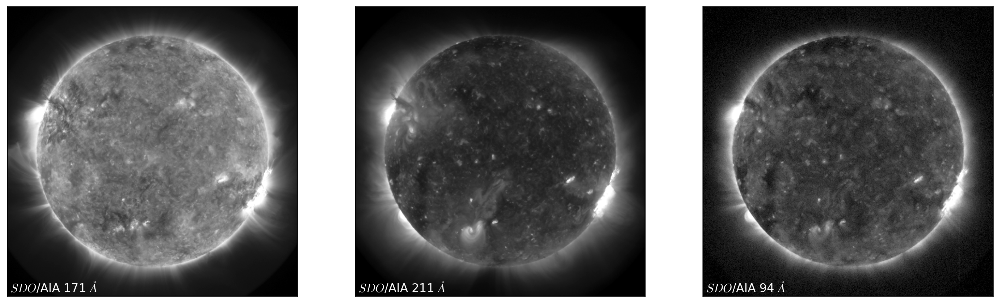

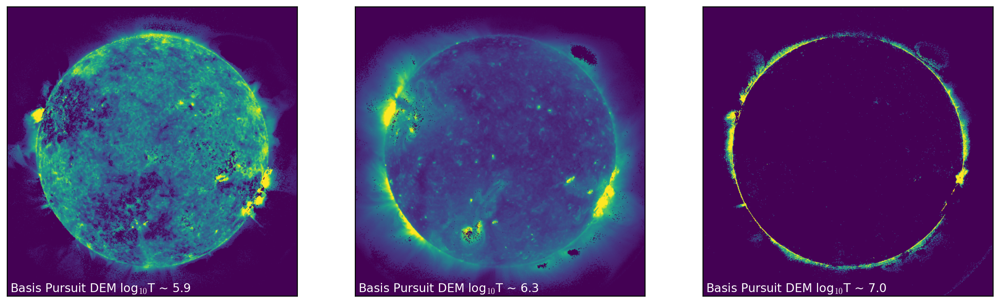

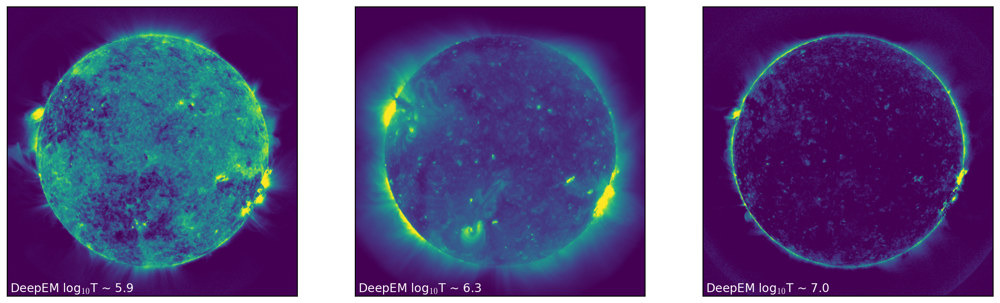

In [23]:
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(X_test[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, '${\it SDO}$/AIA 211 $\AA$', color="white", size='large')
ax[0].imshow(X_test[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, '${\it SDO}$/AIA 171 $\AA$', color="white", size='large')
ax[2].imshow(X_test[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, '${\it SDO}$/AIA 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(dem_in_test_trn[0,8,:,:].cpu().detach().numpy(),vmin=0.25,vmax=10,cmap='viridis')
ax[1].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 6.3', color="white", size='large')
#ax[1].scatter(x=[400], y=[80], c='w', s=50, marker='x') 
ax[0].imshow(dem_in_test_trn[0,4,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[0].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 5.9', color="white", size='large')
ax[2].imshow(dem_in_test_trn[0,15,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[2].text(5, 512.-7.5, 'Basis Pursuit DEM log$_{10}$T ~ 7.0', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(dem_pred_trn[0,8,:,:].cpu().detach().numpy(),vmin=0.25,vmax=10,cmap='viridis')
ax[1].text(5, 512.-7.5, 'DeepEM log$_{10}$T ~ 6.3', color="white", size='large')
#ax[1].scatter(x=[400], y=[80], c='w', s=50, marker='x') 
ax[0].imshow(dem_pred_trn[0,4,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[0].text(5, 512.-7.5, 'DeepEM log$_{10}$T ~ 5.9', color="white", size='large')
ax[2].imshow(dem_pred_trn[0,15,:,:].cpu().detach().numpy(),vmin=0.01,vmax=3,cmap='viridis')
ax[2].text(5, 512.-7.5, 'DeepEM log$_{10}$T ~ 7.0', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)

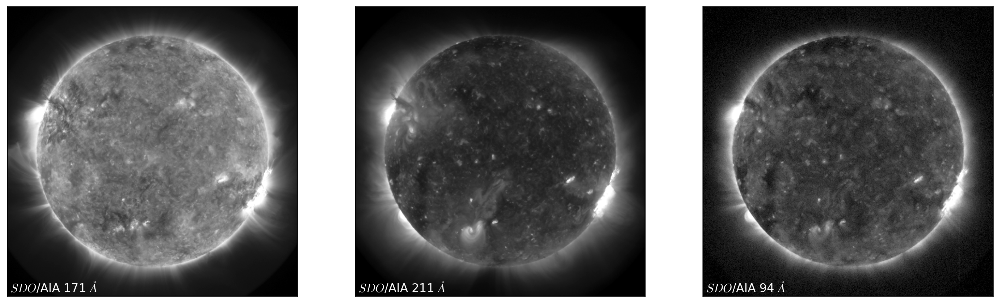

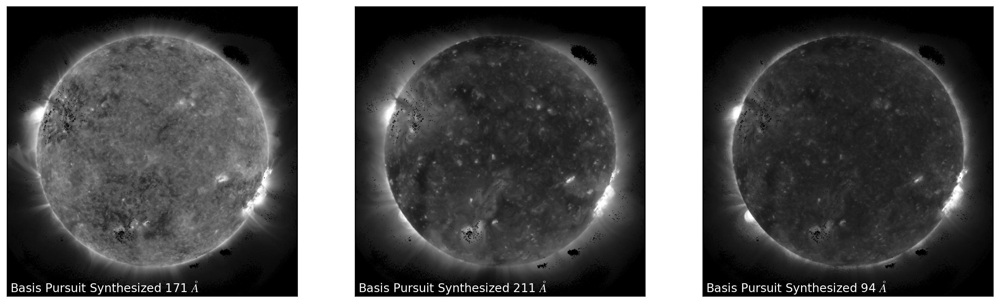

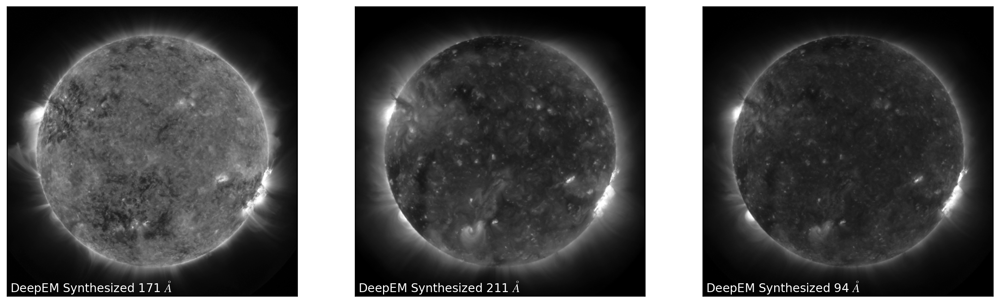

In [24]:
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(X_test[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, '${\it SDO}$/AIA 211 $\AA$', color="white", size='large')
ax[0].imshow(X_test[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, '${\it SDO}$/AIA 171 $\AA$', color="white", size='large')
ax[2].imshow(X_test[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, '${\it SDO}$/AIA 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(AIA_out[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, 'Basis Pursuit Synthesized 211 $\AA$', color="white", size='large')
ax[0].imshow(AIA_out[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, 'Basis Pursuit Synthesized 171 $\AA$', color="white", size='large')
ax[2].imshow(AIA_out[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, 'Basis Pursuit Synthesized 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)
    
fig,ax=plt.subplots(ncols=3,figsize=(9*2,9))

ax[1].imshow(AIA_out_DeepEM[0,4,:,:],vmin=0.25,vmax=25,cmap='Greys_r')
ax[1].text(5, 512.-7.5, 'DeepEM Synthesized 211 $\AA$', color="white", size='large')
ax[0].imshow(AIA_out_DeepEM[0,2,:,:],vmin=0.01,vmax=30,cmap='Greys_r')
ax[0].text(5, 512.-7.5, 'DeepEM Synthesized 171 $\AA$', color="white", size='large')
ax[2].imshow(AIA_out_DeepEM[0,0,:,:],vmin=0.01,vmax=3,cmap='Greys_r')
ax[2].text(5, 512.-7.5, 'DeepEM Synthesized 94 $\AA$', color="white", size='large')

for axes in ax:
    axes.get_xaxis().set_visible(False)
    axes.get_yaxis().set_visible(False)